
# Фидбэк, работа над ошибками

#### **Не надо писать код в live режиме**

Согласен --- на это уходит много времени и понимания это не прибавляет. В реп буду выкладывать 2 версии семов --- c `# write your code` и `solved`, если кто-то захочет дома самостоятельно прорешать сем.

---

#### **Придётся пересматривать семинар заново, разбираться самостоятельно.**

Я перезаписал разбор семинара, он есть на youtube (ссылка запинена в телеграме). Старался сделать его более подробным и продуманным.

---

#### **Почему возникал баг при обучении модели (accuracy оставалась на уровне 0.5)**

Скорее всего, был большой `learning_rate`

---

#### **Может онлайн?)**

Материалы сема и домашки есть в репе. Записи --- на youtube

---

#### **Не слышно**

Есть гипотеза, что если я оптимизировать вовлеченность, то станет слышно. Не слышно было, потому что шумно

---

#### **Не структурировано**

* оглавление в ноутбуке
* будем подводить итоги после нового пункта
* в конце семинара делаем блиц --- разбираем ответы на важные вопросы
* таймкоды на записи
* я заранее буду репетировать сем, рассказывать самому себе

---


# План семинара


[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/m12sl/dl-hse-2021/blob/master/02-pytorch/seminar.ipynb)


**Теория**
* картинки
* рассмотрим свертки поближе

**Pytorch**
* попробовать писать логи tensorboard
* научиться сохранять/доставать чекпоинты
* разобраться с Dataset API
* написать базовый Trainer - класс с тренировочным циклом

**Блицы**
* блиц по сверткам
* блиц по pytorch

Попробуйте дома прорешать семинар самостоятельно!

# Картинки


**Вопрос**: Что хранится в значении пикселя? (число от 0 до 255)

**Вопрос**: Что если все цвета 255?

**Вопрос**: Что если все цвета 0?

**Вопрос**: Что если `red = 255`, а `green = blue = 0`?

**Вопрос**: Что если все каналы равны друг другу?

In [ ]:
[ 1, 64, 64 ]

[ 3, 64, 64 ]

In [22]:
!wget https://i.imgflip.com/62ixgw.jpg

--2022-01-25 16:58:39--  https://i.imgflip.com/62ixgw.jpg
Resolving i.imgflip.com (i.imgflip.com)... 104.18.255.14, 104.18.64.15
Connecting to i.imgflip.com (i.imgflip.com)|104.18.255.14|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 69445 (68K) [image/jpeg]
Saving to: ‘62ixgw.jpg.1’

62ixgw.jpg.1        100%[===================>]  67.82K  --.-KB/s    in 0.006s  

2022-01-25 16:58:39 (10.9 MB/s) - ‘62ixgw.jpg.1’ saved [69445/69445]



У изображений обычно 3 канала. Мы будем работать с RGB-каналами. Значение каждого пикселя [0..255] -- это его яркость

In [24]:
import cv2
import matplotlib.pyplot as plt

img_bgr = cv2.imread("./62ixgw.jpg")
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
img_rgb.shape

(433, 577, 3)

In [ ]:
img_rgb[:3, :3, :]

array([[[155, 181, 204],
        [157, 183, 206],
        [160, 186, 209]],

       [[145, 171, 194],
        [151, 177, 200],
        [158, 184, 207]],

       [[136, 162, 185],
        [140, 166, 189],
        [145, 171, 194]]], dtype=uint8)

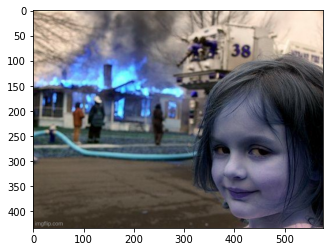

In [ ]:
plt.imshow(img_bgr)

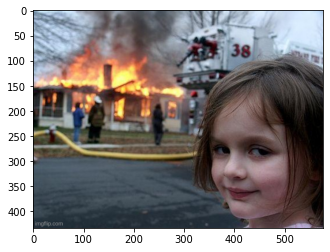

In [25]:
plt.imshow(img_rgb)

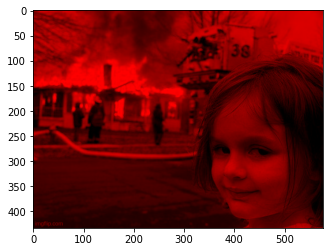

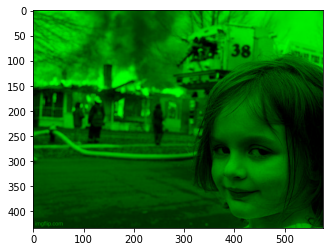

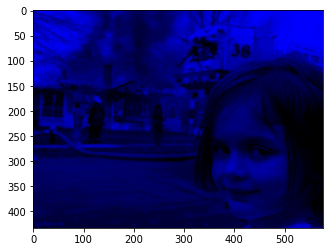

In [ ]:
for i in range(3):
    plt.figure(i)
    img_copy = img_rgb.copy()
    img_copy[:, :, (i + 1) % 3] = 0
    img_copy[:, :, (i + 2) % 3] = 0
    plt.imshow(img_copy)

# Свертки

Дока [pytorch Conv2d](https://pytorch.org/docs/stable/generated/torch.nn.Conv2d.html)

* **kernel_size** --- размер ядра свертки (так ядро иногда называют фильтром). На гифке размер ядра 3 на 3. Можно сделать несимметричную свертку (например, 1 на 10), но на практике используют симметричные
* **padding** --- отступ, ширина "рамочки", котрая будет дорисовываться вокруг нашего изображения

**Важно**: ядро -- это серый квадратик (3x3), который бегает по синему  квадратику. Зеленый квадратик -- это результат работы свертки.




<img src="https://cdn-images-1.medium.com/max/1600/0*1PSMTM8Brk0hsJuF." width=450 height=400>

### Пример для многослойной свертки

Забегая вперед, это визуализация тут `nn.Conv2d(3, 2, kernel_size=3)`

Результаты свертки каждого скользящего окна складываются


https://cs231n.github.io/convolutional-networks/#conv



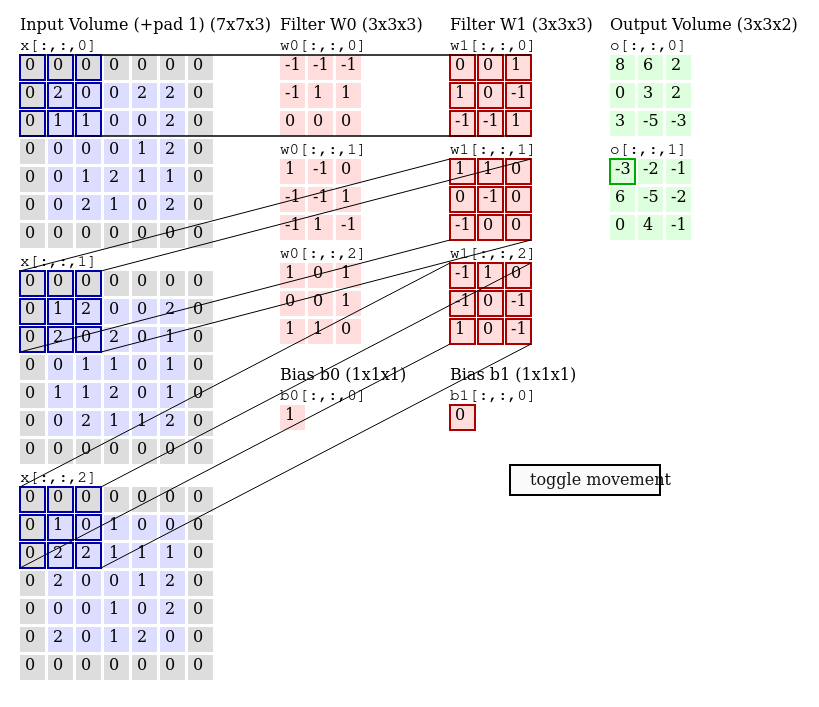

## Попробуем применить свертку к изображению

A)
```
[0, 0, 0],
[0, 1, 0],
[0, 0, 0]
```
Б)
```
[0, 1, 0],
[0, -2, 0],
[0, 1, 0]
```
В)
```
[0, 0, 0],
[1, -2, 1],
[0, 0, 0]
```
Г)
```
[0, 1, 0],
[1, -4, 1],
[0, 1, 0]
```
Д)
```
[0, -1, 0],
[-1, 5, -1],
[0, -1, 0]
```
Е)
```
[0.0625, 0.125, 0.0625],
[0.125, 0.25, 0.125],
[0.0625, 0.125, 0.0625]
```


In [26]:
!wget https://www.hse.ru/data/2021/08/25/1414838109/3HSE-8086_Preview.jpeg -O hse.jpeg

--2022-01-25 17:14:21--  https://www.hse.ru/data/2021/08/25/1414838109/3HSE-8086_Preview.jpeg
Resolving www.hse.ru (www.hse.ru)... 186.2.163.228
Connecting to www.hse.ru (www.hse.ru)|186.2.163.228|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 59741 (58K) [image/jpeg]
Saving to: ‘hse.jpeg’

hse.jpeg            100%[===================>]  58.34K   208KB/s    in 0.3s    

2022-01-25 17:14:23 (208 KB/s) - ‘hse.jpeg’ saved [59741/59741]



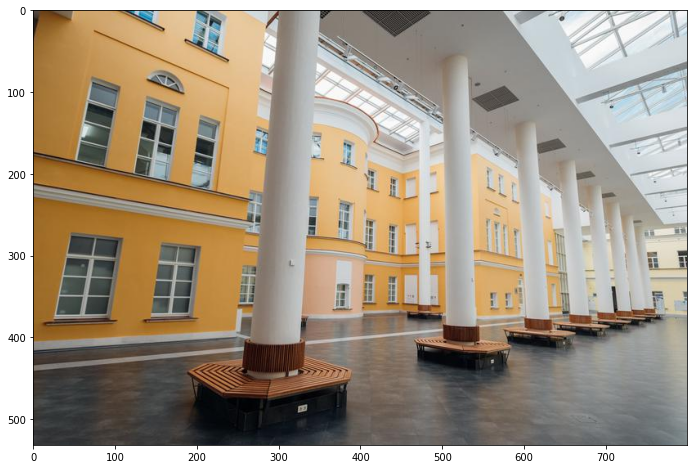

In [27]:
import cv2
import matplotlib.pyplot as plt

img = cv2.imread("./hse.jpeg")
RGB_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(12, 8))
plt.imshow(RGB_img)
plt.show()


In [33]:
import torch
import torch.nn as nn
from torch.nn import functional as F

img_t = torch.from_numpy(RGB_img).type(torch.float32).unsqueeze(0)
kernel = torch.tensor([
    [0, 0, 0],
    [0, 1, 0],
    [0, 0, 0]
]).reshape(1, 1, 3, 3).type(torch.float32)

kernel = kernel.repeat(3, 3, 1, 1)
img_t = img_t.permute(0, 3, 1, 2)  # [BS, H, W, C] -> [BS, C, H, W]
img_t = nn.ReflectionPad2d(1)(img_t)  # Pad Image for same output size

result = F.conv2d(img_t, kernel)[0]  #

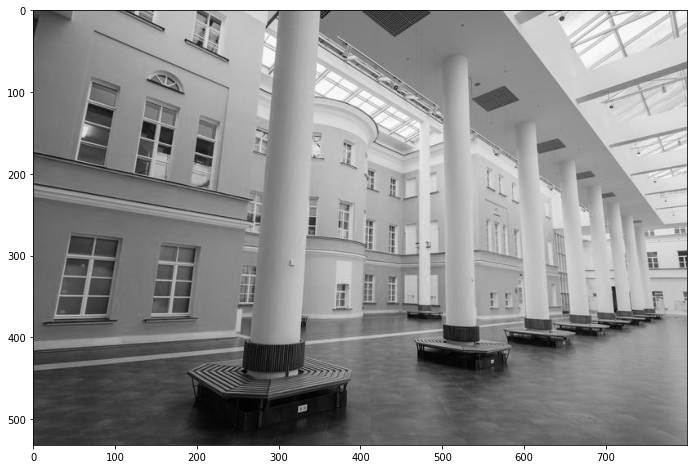

In [34]:
plt.figure(figsize=(12, 8))
result_np = result.permute(1, 2, 0).numpy() / 256 / 3

plt.imshow(result_np[:, :, :])
plt.show()

**Вопрос:** почему изображение потеряло цвет?

Для каждого пикселя каждого слоя наша свертка берет усредненный цвет по всем слоям.

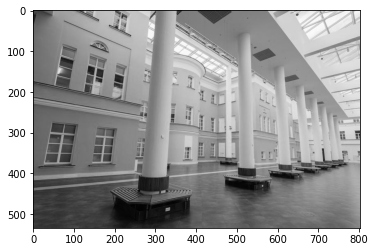

In [30]:
# на самом деле, наша свертка эквивалентна вот такому преобразованию
# усреднение по каналам
plt.imshow(img_t.mean(1).repeat(3, 1, 1).permute(1, 2, 0).numpy() / 255)

# Практика обучения моделей


In [36]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter


from tqdm.auto import tqdm

## Логирование


Популярным вариантом для хранения логов является tensorboard: это формат хранения (protobuf, как json только бинарный) + готовый просмотрщик.




[Tensorboard](https://www.tensorflow.org/tensorboard) -- это pip-installable web-приложение.

```
tensorboard --logdirs=./some-folder/with/events-files
# зайти на http://localhost:6006
```
<img src="https://www.researchgate.net/publication/335864383/figure/fig1/AS:804107535265792@1568725584130/A-screen-capture-of-the-TensorBoard-output-from-a-model-trained-in-HIPSTER-on-simulated.jpg"/>

При желании, можно написать python-код для парсинга логов и делать что-то с ними руками.

Чтобы писать логи в pytorch есть класс `torch.utils.tensorboard.SummaryWriter`

In [37]:
writer = SummaryWriter("./check-this/")

fake_loss = 1 / np.arange(1, 100)
for global_step, point in enumerate(fake_loss):
    writer.add_scalar("lossy", point, global_step=global_step)
writer.close()

## Запускаем TensorBoard

В случае локального запуска (или на своем сервере) потребуется поставить tensorboard
```
pip install tensorboard

tensorboard --logdir=./check-this
# зайти на http://localhost:6006
```

Для работы в colab есть специальное расширение. Запустите следующие ячейки:

In [38]:
%load_ext tensorboard

In [39]:
%tensorboard --logdir ./check-this

<IPython.core.display.Javascript object>

## Сохранение-загрузка тензоров и моделек

Нам часто бывает необходимо сохранить/загрузить веса модели в файл на диске. 
Распространенное название для этого -- checkpoint. 

У торчевых моделей (наследников torch.nn.Module) и оптимизаторов (наследников torch.optim.Optimizer) есть методы для получения и загрузки состояний:

`.state_dict()` возвращает словарь (или почти словарь) с весами

`.load_state_dict(some_dict)` загружает веса из словаря в модельку

Для сохранения/загрузки словарей с тензорами в файлы есть простые функции `torch.save(some_dict, path)` и `torch.load(path)`. Сравните с использованием pickle или json!

**NB: В DL термином checkpointing называют так же метод бекпропа, позволяющий экономить память ценой дополнительных вычислений (https://pytorch.org/docs/stable/checkpoint.html#torch-utils-checkpoint).**

In [40]:
some_model = nn.Sequential(nn.Linear(10, 10))
print(some_model.state_dict())

opt = optim.Adam(some_model.parameters())
print(opt.state_dict())

torch.save({"model_stuff": some_model.state_dict(), "opt_stuff": opt.state_dict()}, "./that.is.it")

OrderedDict([('0.weight', tensor([[ 0.0849, -0.1586,  0.3102,  0.1195,  0.0131, -0.0793, -0.1233, -0.2918,
          0.2823, -0.2535],
        [ 0.0480,  0.2830,  0.2664,  0.1328, -0.1758, -0.2169,  0.0373, -0.0931,
          0.1852,  0.0100],
        [-0.1228, -0.1601, -0.1867, -0.2802,  0.2254,  0.1368,  0.2652, -0.1312,
          0.1117, -0.2606],
        [ 0.0507, -0.2978, -0.2480,  0.1029,  0.1784,  0.2984,  0.2147, -0.3038,
          0.2432,  0.1698],
        [-0.1907, -0.0795, -0.0118,  0.0192,  0.2950, -0.2732,  0.0599,  0.0044,
         -0.1538,  0.2764],
        [ 0.2773, -0.1825, -0.2366,  0.1332,  0.0922,  0.0233, -0.2144, -0.1643,
          0.1423, -0.2901],
        [ 0.1194, -0.0090, -0.2933,  0.2948, -0.1569,  0.1621, -0.2487, -0.1028,
         -0.0757, -0.0968],
        [-0.0299,  0.2843,  0.1952, -0.0032, -0.1941, -0.1161, -0.0434,  0.0907,
         -0.1454,  0.2463],
        [ 0.2424,  0.1792,  0.2255,  0.1763,  0.0535,  0.1785, -0.3077, -0.1969,
         -0.1725,  0.

In [41]:
torch.load("./that.is.it")

{'model_stuff': OrderedDict([('0.weight',
               tensor([[ 0.0849, -0.1586,  0.3102,  0.1195,  0.0131, -0.0793, -0.1233, -0.2918,
                         0.2823, -0.2535],
                       [ 0.0480,  0.2830,  0.2664,  0.1328, -0.1758, -0.2169,  0.0373, -0.0931,
                         0.1852,  0.0100],
                       [-0.1228, -0.1601, -0.1867, -0.2802,  0.2254,  0.1368,  0.2652, -0.1312,
                         0.1117, -0.2606],
                       [ 0.0507, -0.2978, -0.2480,  0.1029,  0.1784,  0.2984,  0.2147, -0.3038,
                         0.2432,  0.1698],
                       [-0.1907, -0.0795, -0.0118,  0.0192,  0.2950, -0.2732,  0.0599,  0.0044,
                        -0.1538,  0.2764],
                       [ 0.2773, -0.1825, -0.2366,  0.1332,  0.0922,  0.0233, -0.2144, -0.1643,
                         0.1423, -0.2901],
                       [ 0.1194, -0.0090, -0.2933,  0.2948, -0.1569,  0.1621, -0.2487, -0.1028,
                        -0.0

## Dataset API


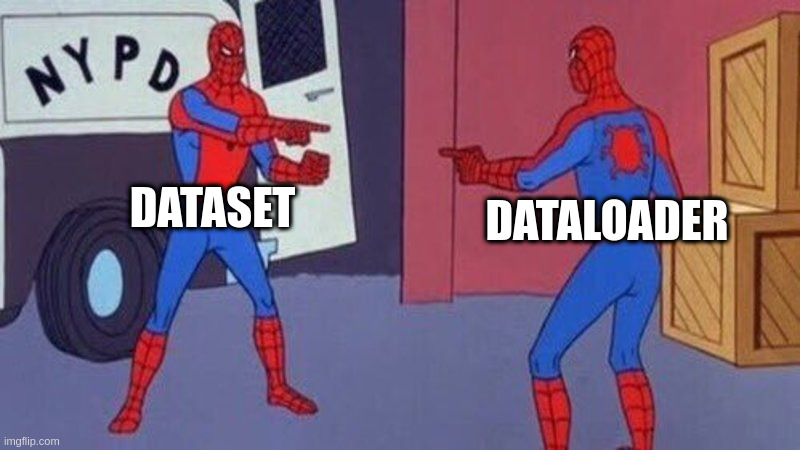


Подготовка данных легко может стать бутылочным горлышком, когда на подготовку очередного батча уходит больше времени, чем на forward+backward проходы по сети.
Проблема усложняется особенностями python: чтобы использовать несколько ядер CPU для подготовки данных надо постараться.

В Pytorch работа с данными строится на двух классах из [torch.utils.data](https://pytorch.org/docs/stable/data.html): `Dataset` и `DataLoader`:

- `Dataset` отвечает за подготовку одного примера
- `DataLoader` отвечает за выбор примеров, склейку их в один батч и распараллеливание на CPU, поддерживает итерирование.


Для решения задачи обычно пишут кастомные Dataset-классы, для этого нужно написать всего две функции:
- `.__len__(self)` возвращает количество примеров в датасете;
- `.__getitem__(self, item)` возвращает item-ный по счету пример из датасета.

Задачи DataLoader достаточно сложно аккуратно реализовать и лучше использовать готовый. Он довольно гибкий, все основные моменты кастомизируются заданием функций:
```
torch.utils.data.DataLoader(
    dataset,            # собственно экземпляр класса Dataset, из которого надо доставать примеры
    batch_size=1,       # количество примеров в батче
    drop_last=False,    # нужно ли при итерировании выбрасывать неполные батчи? (такое бывает, если число примеров не делится нацело на batch_size
    shuffle=False,      # перемешивать ли примеры
    sampler=None,       # чтобы перемешивать примеры кастомно
    batch_sampler=None, # чтобы использовать кастомный отбор примеров в батч
    num_workers=0,      # на сколько процессов запараллелить подготовку данных
    collate_fn=None,    # функция, которая будет склеивать примеры в батчи
    # остальные аргументы более технические, сейчас можно не рассматривать
    pin_memory=False,   
    timeout=0, 
    worker_init_fn=None, 
    multiprocessing_context=None, 
    generator=None)
```

Напишите два датасета для работы с FashionMnist: один готовит данные как вектора, другой как картинки


**NB: FashionMNIST возвращает картинки в формате PIL.Image.Image, чтобы сделать из него понятный np.array, просто вызовите np.array(PIL_IMAGE)**

In [42]:
from torchvision.datasets import FashionMNIST
import matplotlib.pyplot as plt
import torch.nn as nn
import numpy as np
fmnist = FashionMNIST("./tmp", train=True, download=True)

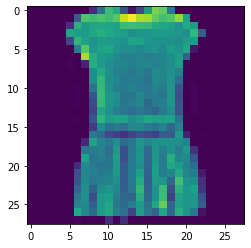

In [44]:
plt.imshow(fmnist[3][0])

In [45]:
np.array(fmnist[0][0]).shape

(28, 28)

In [46]:
from collections import namedtuple
from torchvision.datasets import FashionMNIST

class VectorSet:
    def __init__(self, train=True):
        self.data = FashionMNIST("./tmp", train=train, download=True)
    
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, item):
        # сделайте вектор с float32 числами
        sample, label = self.data[item]
        sample = np.array(sample, dtype=np.float32).reshape(-1) / 255
        return dict(
            sample=sample,
            label=label,
        )

vs = VectorSet()
print(vs[0]['sample'].shape)
        
class ImageSet:
    def __init__(self, train=True):
        self.data = FashionMNIST("./tmp", train=train, download=True)
    
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, item):
        # сделайте одноканальную картинку [1, 28, 28] с float32
        sample, label = self.data[item]
        sample = np.array(sample, dtype=np.float32)[None:, ...] / 255

        return dict(
            sample=sample,
            label=label,
        )
    
ms = ImageSet()
print(ms[0]['sample'].shape)

(784,)
(28, 28)


In [47]:
# проверьте итерирование, именно его мы используем в train-loop'е
vl = DataLoader(vs, batch_size=4)
for batch in vl:
    for k, v in batch.items():
        print(k, v.shape)
    break

sample torch.Size([4, 784])
label torch.Size([4])


In [48]:
# проверьте итерирование, именно его мы используем в train-loop'е
ml = DataLoader(ms, batch_size=4)
for batch in ml:
    for k, v in batch.items():
        print(k, v.shape)
    break

sample torch.Size([4, 28, 28])
label torch.Size([4])


## Замечания по Dataset/Dataloader

1. Dataset может возвращать что угодно (туплы, словари, whatever) с отдельными числами или массивами (numpy, torch.tensor).
Удобно возвращать словари с читабельными ключами, тогда будет проще разделять логику по компонентам.

2. Имеет смысл поглядеть в [стандартный collate_fn](https://github.com/pytorch/pytorch/blob/master/torch/utils/data/_utils/collate.py#L42): он умеет клеить в батчи и конвертировать в тензора самые разнообразные данные. Это может работать во многих случаях, но неожиданно падать в других. В частности, не сможет поклеить примеры разной длины.


# Classy Trainer

Пишем класс для тренировки и логгирования.

In [54]:
class Trainer:
    def __init__(self, model, optimizer, train_dataset, val_dataset, batch_size=128):
        self.model = model
        self.optimizer = optimizer
        self.train_dataset = train_dataset
        self.val_dataset = val_dataset

        self.batch_size = batch_size

        self.device = 'cpu'
        if torch.cuda.is_available():
            self.device = torch.cuda.current_device()
            self.model = self.model.to(self.device)

        self.global_step = 0
        self.writer = SummaryWriter("./tmp/")

    def save_checkpoint(self, path):
        torch.save(self.model.state_dict(), path)

    def train(self, num_epochs):
        model = self.model
        optimizer = self.optimizer
        
        train_loader = DataLoader(self.train_dataset, shuffle=True, pin_memory=True, batch_size=self.batch_size)

        # валидационный датасет не стоит перемешивать!
        val_loader = DataLoader(self.val_dataset, shuffle=False, pin_memory=True, batch_size=self.batch_size)
        best_loss = float('inf')
        
        for epoch in range(num_epochs):
            model.train()
            for batch in tqdm(train_loader):
                batch = {k: v.to(self.device) for k, v in batch.items()}
                loss, details = model.compute_all(batch)
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
                for k, v in details.items():
                    self.writer.add_scalar(k, v, global_step=self.global_step)

                # self.writer.add_scalar("loss", loss.item(), global_step=self.global_step)

                self.global_step += 1
            
            model.eval()

            val_losses = []
            for batch in tqdm(val_loader):
                batch = {k: v.to(self.device) for k, v in batch.items()}
                loss, details = model.compute_all(batch)
                val_losses.append(loss.item())
                
            val_loss = np.mean(val_losses)        
            if val_loss < best_loss:
                self.save_checkpoint("./best_checkpoint.pth")
                best_loss = val_loss

                



In [51]:
class VeryModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.inner = nn.Sequential(
            nn.Linear(784, 100),
            nn.ReLU(),
            nn.Linear(100, 10),
        )

        # nn.Sequential последовательно применяет переданные слои
        # self.linear_1 = nn.Linear(784, 100)
        # self.activation = nn.ReLU(),
        # self.linear_2 = nn.Linear(100, 10),

    def forward(self, x):
        return self.inner(x)
        # return self.inner.forward(x) # def __call__(self, x): return self.forward(x)

        # Эквивалентро применению sequential
        # out = self.linear_1(x)
        # out = self.activation(out)
        # out = self.linear_2(out)
        # return out
    
    def compute_all(self, batch):  # удобно сделать функцию, в которой вычисляется лосс по пришедшему батчу
        x = batch['sample']
        y = batch['label']
        logits = self.inner(x)
        
        loss = F.cross_entropy(logits, y)
        acc = (logits.argmax(axis=1) == y).float().mean().cpu().numpy()
        metrics = dict(acc=acc)
        return loss, metrics

# проверяйте работоспособность сразу
model = VeryModel()
opt = optim.SGD(model.parameters(), lr=1e-2)
trainset = VectorSet(train=True)
valset = VectorSet(train=False)

trainer = Trainer(model, opt, trainset, valset, batch_size=128)

In [52]:
trainer.train(5)

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

In [55]:
ms[0]['sample'][None, :, :].shape

(1, 28, 28)

In [ ]:
torch.ones([5, 3, 28, 28]).flatten(2).shape

In [56]:
nn.Conv2d(1, 8, kernel_size=3, padding=0)(torch.ones([1, 1, 28,28])).shape

torch.Size([1, 8, 26, 26])

In [57]:
28 * 28

784

In [71]:
class Dbg(nn.Module):
    def forward(self, x):
        print("x.shape", x.shape)
        return x

In [72]:
class CNNModel(nn.Module):
    def __init__(self):
        super().__init__()
        self.inner = nn.Sequential(
            # [ bs, ch, w, h ]
            nn.Conv2d(1, 8, kernel_size=3, padding=1), # [ bs, 8, w, h ]
            Dbg(),
            nn.ReLU(),
            nn.Conv2d(8, 3, kernel_size=3, padding=1), # [ bs, 3, w, h ]

            nn.Flatten(1), # [ bs, 3 * w * h ]
            nn.Linear(3 * 28 * 28, 10), # [ bs, 10 ]
        )

    def forward(self, x):
        return self.inner(x)
    
    def compute_all(self, batch):  # удобно сделать функцию, в которой вычисляется лосс по пришедшему батчу
        x = batch['sample']
        y = batch['label']
        x = x.unsqueeze(1)
        # print(x.shape)
        logits = self.inner(x) # [ bs, 10 ]
        assert logits.size() == torch.Size([ x.size(0), 10 ]), f"logits size is wrong: {logits.size}"
        
        loss = F.cross_entropy(logits, y)
        acc = (logits.argmax(axis=1) == y).float().mean().cpu().numpy()
        metrics = dict(acc=acc)
        return loss, metrics

# проверяйте работоспособность сразу
cnn_model = CNNModel()
cnn_opt = optim.SGD(cnn_model.parameters(), lr=1e-2)
cnn_trainset = ImageSet(train=True)
cnn_valset = ImageSet(train=False)

cnn_trainer = Trainer(cnn_model, cnn_opt, cnn_trainset, cnn_valset, batch_size=128)

In [73]:
cnn_trainer.train(3)

  0%|          | 0/469 [00:00<?, ?it/s]

x.shape torch.Size([128, 7, 28, 28])


RuntimeError: ignored

In [65]:
cnn_trainer.train(3)

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/79 [00:00<?, ?it/s]

In [63]:
sum( p.numel() for p in model.parameters() if p.requires_grad)

79510

In [62]:
sum( p.numel() for p in cnn_model.parameters() if p.requires_grad)

23829

Просмотрите логи локально или через tensorboard-ext в зависимости от того, как вы запустили тетрадку

In [64]:
%tensorboard --logdir ./tmp

Reusing TensorBoard on port 6007 (pid 935), started 0:08:54 ago. (Use '!kill 935' to kill it.)

<IPython.core.display.Javascript object>

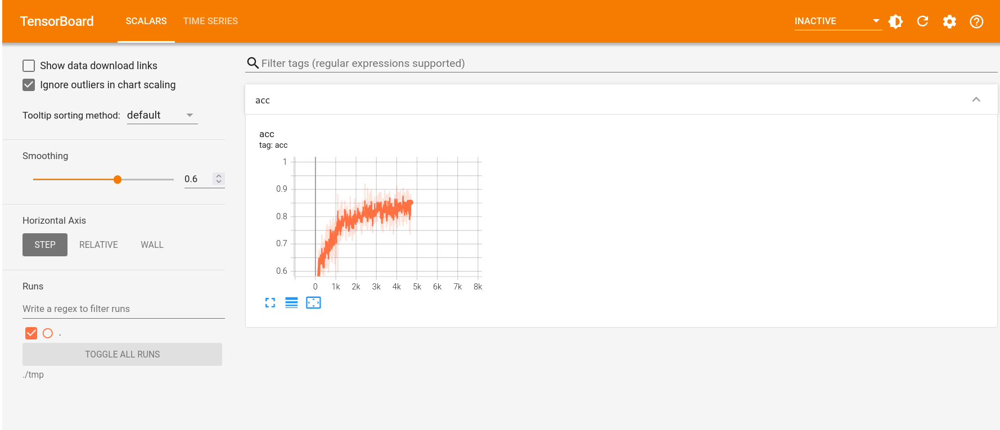

# Блиц по сверткам

### Какие основные параметры у свертки? 

<!-- 
Обучаемые параметры
* in/out + kernel_size # одна матрица размерности `[in, out, kernel_size[0], kernel_size[1]]`

Параметры, влияющие на процесс вычисления свертки
* padding
* stride -->


In [66]:
sum(map(lambda x: x.numel(), nn.Conv2d(3, 3, kernel_size=3).parameters()))

84


### Сколько параметров будет у свертки `nn.Conv2d(3, 3, kernel_size=3)`
<!-- 

nn.Conv2d(3, 3, kernel_size=3)

[3, 3, 3, 3]

kernel_size=3 ~ kernel_size=(3, 3)

```python
a
``` -->

### Как вы думаете, какие ядра выучивают реальные нейросетки на настоящих картинках?

<!-- Вообще говоря, принято считать, что фильтры выучиват текстуры. И используя это можно обмануть нейросеетвой классификатор, например, если показать ему рыбу с текстурой чешуи как кожа коровы, то классификатор, скорее всего будет считать это коровой.

Сами ядра можно визуализировать

https://deeplizard.com/learn/video/cNBBNAxC8l4

<img src="https://deeplizard.com/assets/jpg/c50ac9ac.jpg"> -->

### В начале сема есть 6 сверток, пронумерованные буквами. Сопоставьте ядра действию, которое делает это ядро:

1) Размытие

2) Увеличение резкости

3) Тождественное преобразование

4) Выделение вертикальных границ

5) Выделение горизонтальных границ

6) Выделение границ
<!-- 
```
A 3
Б 4
В 5
Г 6
Д 1
Е 2
``` -->

# Блиц по `Pytorch`

### Что нужно сохранять для того, чтобы сохранить текущее состояние обучения/модели?

<!-- На саммо деле ответ уже есть в вопросе -- сохраняем `state_dict` для модели и для оптимизатора -->


### Когда нужно сохранять состояние модели/оптимизатора?

<!-- 

Вообще говоря, зависит от конкретной задачи, датасета и цели.

Есть разные стратегии сохраннения чекпоинтов:
* можно сохранять чекпоинты в конце каждой эпохи
* можно сохранять N последних чекпоинта
* можно сохранять N лучших чекпоинтов (по метрике или лоссу)
* можно сохранять чекпоинты через k шагов обновления (если в эпохе очень много шагов)

 -->


### Чем отличается Dataset от Dataloader?
<!--
- `Dataset` отвечает за подготовку одного примера
- `DataLoader` отвечает за выбор примеров, склейку их в один батч и распараллеливание на CPU, поддерживает итерирование.
-->

### Зачем нужна `collate_fn`?

<!-- Функция, которая будет склеивать примеры в батчи -->

## Расставьте этапы обучения модели в правильном порядке

* получение примеров для обучения из датасета
* обновление весов сети
* backward pass
* forward pass + вычисление лосса
* обнуление градиентов `model.zero_grad()`
* сохранение чекпоинта

<!-- 

Правильный порядок:

* получение примеров для обучения из датасета
* обнуление градиентов `model.zero_grad()`
* forward pass + вычисление лосса
* backward pass
* обновление весов сети
* [например, в конце эпохи] сохранение чекпоинта

 -->